# AI Metdata Engine For Video Processing

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import torch
import IPython.display as ipd
import json

from tqdm.notebook import tqdm

import subprocess
import cv2


# Input tjhe path of the video file ibn Input_file to render video
input_file = '/kaggle/input/driving-video-with-object-tracking/bdd100k_videos_train_00/bdd100k/videos/train/0010bf16-9ee17cd9.mov'

#subprocess will convert the video file to mp4 format 
subprocess.run(['ffmpeg','-i', 
                input_file, 
                '-qscale', '0',
                '0010bf16-9ee17cd9.mp4',
                '-loglevel',
                'quiet']
              )


ffmpeg: /opt/conda/lib/libncursesw.so.6: no version information available (required by /lib/x86_64-linux-gnu/libcaca.so.0)
ffmpeg: /opt/conda/lib/libncursesw.so.6: no version information available (required by /lib/x86_64-linux-gnu/libcaca.so.0)


CompletedProcess(args=['ffmpeg', '-i', '/kaggle/input/driving-video-with-object-tracking/bdd100k_videos_train_00/bdd100k/videos/train/0010bf16-9ee17cd9.mov', '-qscale', '0', '0010bf16-9ee17cd9.mp4', '-loglevel', 'quiet'], returncode=0)

In [5]:
#it will list and show the mp4 rendered video in the the working directory
!ls -Gflash --color


total 11M
4.0K drwxr-xr-x 5 root 4.0K Mar 17 13:34 ..
4.0K drwxr-xr-x 3 root 4.0K Mar 17 13:44 .
4.0K ---------- 1 root  263 Mar 17 13:33 __notebook_source__.ipynb
 11M -rw-r--r-- 1 root  11M Mar 17 13:45 0010bf16-9ee17cd9.mp4
4.0K drwxr-xr-x 2 root 4.0K Mar 17 13:34 .virtual_documents


# Displaying Video

In [3]:
#Displaying the video
ipd.Video('0010bf16-9ee17cd9.mp4', width=600, embed = True)

# Open the video and read Metadata of video

In [4]:
cap = cv2.VideoCapture('0010bf16-9ee17cd9.mp4')

In [5]:
# Calculating Total Number of Frames in Video
cap.get(cv2.cv2.CAP_PROP_FRAME_COUNT)


1201.0

In [14]:
# Video Height and Width
height = cap.get(cv2.cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.cv2.CAP_PROP_FRAME_WIDTH)
print(f'Height: {height} and Width: {width}')

Height: 720.0 and Width: 1280.0


In [15]:
# calculating FPS of the video

fps = cap.get(cv2.cv2.CAP_PROP_FPS)
print(f'FPS: {fps:0.2f}')

FPS: 29.97


In [ ]:
cap.release()

# Pulling in Images from Video

In [16]:
cap = cv2.VideoCapture('0010bf16-9ee17cd9.mp4')
ret, img = cap.read()
print(f'Returned {ret} and img of shape {img.shape}')

Returned True and img of shape (720, 1280, 3)


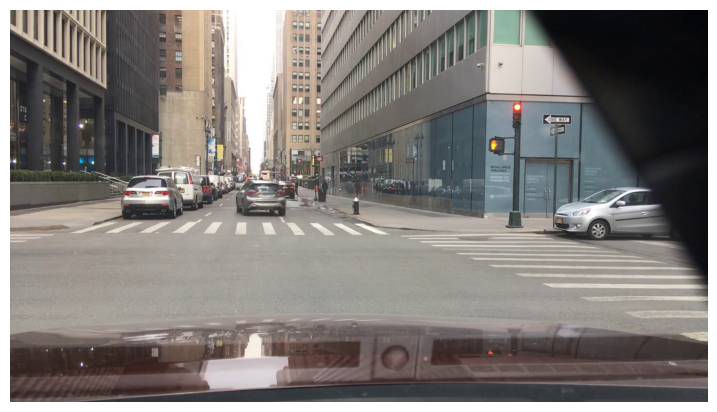

In [15]:
# Helper function for plotting opencv images
def display_img(img, figsize=(9,9)):
    img_ = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(img_)
    ax.axis("off")

display_img(img)

In [ ]:
cap.release()

# Multiple Frames from the Video

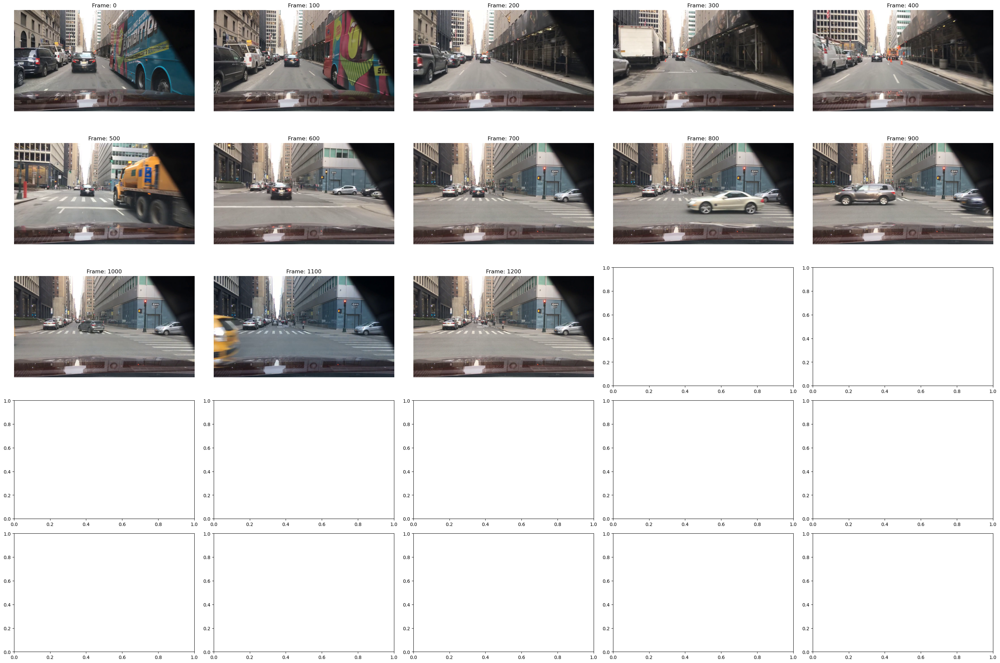

In [6]:
# Plotting the multiple frames of video
# To understad the and capture diffrent frames of video on opencv

fig, axs = plt.subplots(5, 5, figsize=(30,20))
axs = axs.flatten()


cap = cv2.VideoCapture('0010bf16-9ee17cd9.mp4')
frames = int(cap.get(cv2.cv2.CAP_PROP_FRAME_COUNT)) #Number of Frames

img_idx=0
for frame in range(frames):
    ret, img = cap.read()
    if ret == False:
        break
    if frame % 100 == 0:
        axs[img_idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) #Displaying frames in RGB format
        axs[img_idx].set_title(f'Frame: {frame}')
        axs[img_idx].axis("off")
        img_idx += 1

plt.tight_layout() # titles for frame
plt.show()         # Displaying the frames on axis 
cap.release()

# Adding Annotations

In [7]:
# Reading the csv files
labels = pd.read_csv('/kaggle/input/driving-video-with-object-tracking/mot_labels.csv', low_memory=False)
video_labels = (labels.query('videoName == "0010bf16-9ee17cd9"').reset_index(drop=True).copy())
video_labels["video_frame"] = (video_labels["frameIndex"] * 11.9).round().astype("int")

In [8]:
#Displaying the category of the objets present in the video
video_labels["category"].value_counts()

car           1956
pedestrian     375
truck          262
bus             54
Name: category, dtype: int64

In [16]:
#Display the particular frame of video, for E.g. frame 1035

cap = cv2.VideoCapture('0010bf16-9ee17cd9.mp4')
n_frames = int(cap.get(cv2.cv2.CAP_PROP_FRAME_COUNT))

img_idx = 0
for frame in range(n_frames):
    ret, img = cap.read()
    if ret == False:
        break
    if frame == 1035:
        break
cap.release()

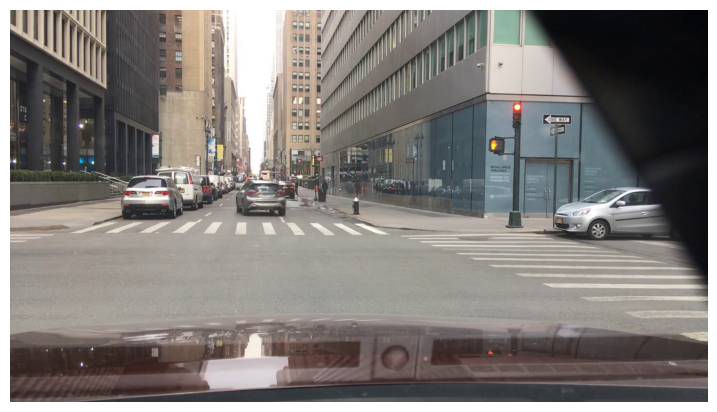

In [17]:
display_img(img)

In [11]:
# assigning dimensions to rectangle to capture objets in video
pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
pt2 = int(d['box2d.x2']), int(d['box2d.y2'])

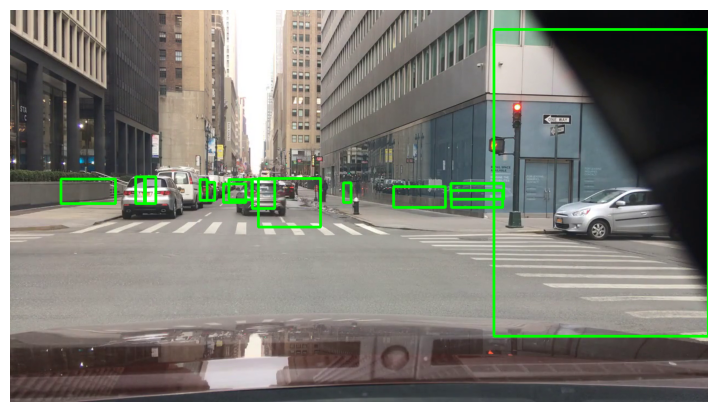

In [18]:
# Displaying the points in shape of rectangle on objects in video

frame_labels = video_labels.query('video_frame == 1035')
for i, d in frame_labels.iterrows():
    pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
    pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
    cv2.rectangle(img, pt1, pt2, (0, 255, 0), 3)

display_img(img)

In [33]:

video_labels["category"].unique()

array(['car', 'truck', 'bus', 'pedestrian'], dtype=object)

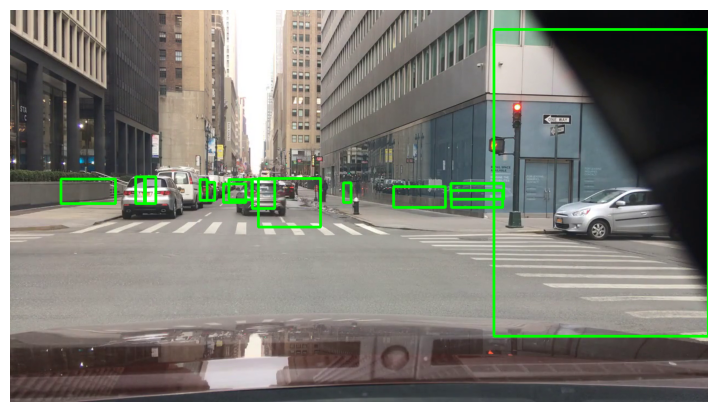

In [19]:
# Color Map dictionary to allocate different color rectangles to different objects
color_map={
    "car":(0,255,0),
    "truck":(0,0,100),
    "pedestrian":(255,0,0),
    "other vehicle":(200,0,150),
    "rider":(200,0,0),
    "bicycle":(0,255,0),
    "other person":(0,0,100),
    "bus":(0,0,200)
}

# different colors to different objects

img_exp = img.copy() 
for i, d in frame_labels.iterrows():
    pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
    pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
    color = color_map[d['category']]
    cv2.rectangle(img,pt1, pt2, color, 3)

display_img(img_exp)

# Adding Text to Frames

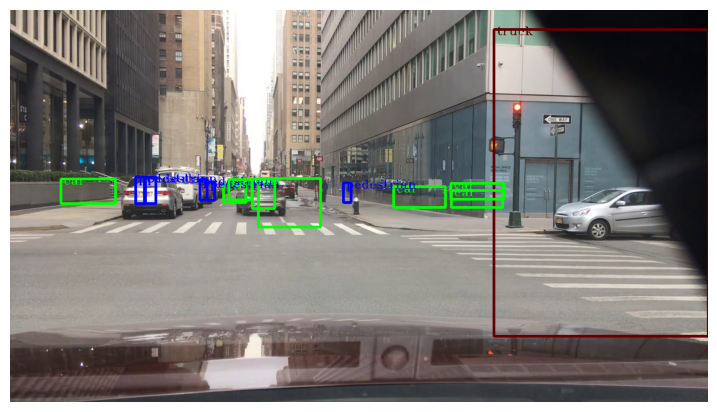

In [22]:
# Adding text to frames based on objects

frame_labels = video_labels.query("video_frame == @frame")
font = cv2.FONT_HERSHEY_TRIPLEX
img_example = img.copy()
for i, d in frame_labels.iterrows():
    pt1 = int(d["box2d.x1"]), int(d["box2d.y1"])
    pt2 = int(d["box2d.x2"]), int(d["box2d.y2"])
    color = color_map[d["category"]]
    img_example = cv2.rectangle(img_example, pt1, pt2, color, 3)
    pt_text = int(d["box2d.x1"]) + 5, int(d["box2d.y1"] + 10)
    img_example = cv2.putText(img_example, d["category"], pt_text, font, 0.7, color)
    
display_img(img_example)
cap.release()

# Label and output Annotated Video

In [24]:
def add_annotations(img, frame, video_labels):
    max_frame = video_labels.query("video_frame <= @frame")["video_frame"].max()
    frame_labels = video_labels.query("video_frame == @max_frame")
    for i, d in frame_labels.iterrows():
        pt1 = int(d["box2d.x1"]), int(d["box2d.y1"])
        pt2 = int(d["box2d.x2"]), int(d["box2d.y2"])
        color = color_map[d["category"]]
        img = cv2.rectangle(img, pt1, pt2, color, 3)
    return img

In [33]:
VIDEO_CODEC = "mp4v"                                       # video codec to mp4 format
fps = 29.97
width = 1280
height = 720
out = cv2.VideoWriter("new1_video.mp4",                     # output video file name
                cv2.VideoWriter_fourcc(*VIDEO_CODEC),
                fps,
                (width, height))

cap = cv2.VideoCapture("0010bf16-9ee17cd9.mp4")             # Input video file name
n_frames = int(cap.get(cv2.cv2.CAP_PROP_FRAME_COUNT))

for frame in tqdm(range(n_frames), total=n_frames):
    ret, img = cap.read()
    if ret == False:
        break
    img = add_annotations(img, frame, video_labels)
    out.write(img)
out.release()
cap.release()

  0%|          | 0/1201 [00:00<?, ?it/s]

In [34]:
!ls -GFlash -color

total 90M
 40M -rw-r--r-- 1 root  40M Mar 17 16:08 new_video.mp4
 40M -rw-r--r-- 1 root  40M Mar 17 16:10 new1_video.mp4
4.0K ---------- 1 root  263 Mar 17 15:55 __notebook_source__.ipynb
 11M -rw-r--r-- 1 root  11M Mar 17 16:01 0010bf16-9ee17cd9.mp4
4.0K drwxr-xr-x 2 root 4.0K Mar 17 15:55 .virtual_documents/
4.0K drwxr-xr-x 5 root 4.0K Mar 17 15:55 ../
4.0K drwxr-xr-x 3 root 4.0K Mar 17 16:09 ./


# Converted labeled output to mp4 and view video

In [35]:
tmp_output_path = "new1_video.mp4"                    # video codec mp4 
output_path = "output1_video.mp4"                     # compressed video mp4
subprocess.run(
    [
        "ffmpeg",
        "-i",
        tmp_output_path,
        "-crf",
        "18",
        "-preset",
        "veryfast",
        "-vcodec",
        "libx264",
        output_path,
        '-loglevel',
        'quiet'
    ]
)

ffmpeg: /opt/conda/lib/libncursesw.so.6: no version information available (required by /lib/x86_64-linux-gnu/libcaca.so.0)
ffmpeg: /opt/conda/lib/libncursesw.so.6: no version information available (required by /lib/x86_64-linux-gnu/libcaca.so.0)


CompletedProcess(args=['ffmpeg', '-i', 'new1_video.mp4', '-crf', '18', '-preset', 'veryfast', '-vcodec', 'libx264', 'output1_video.mp4', '-loglevel', 'quiet'], returncode=0)

In [36]:
!ls -GFlash --color

total 112M
4.0K drwxr-xr-x 3 root 4.0K Mar 17 16:10 ./
4.0K drwxr-xr-x 5 root 4.0K Mar 17 15:55 ../
4.0K drwxr-xr-x 2 root 4.0K Mar 17 15:55 .virtual_documents/
 11M -rw-r--r-- 1 root  11M Mar 17 16:01 0010bf16-9ee17cd9.mp4
4.0K ---------- 1 root  263 Mar 17 15:55 __notebook_source__.ipynb
 40M -rw-r--r-- 1 root  40M Mar 17 16:10 new1_video.mp4
 40M -rw-r--r-- 1 root  40M Mar 17 16:08 new_video.mp4
 23M -rw-r--r-- 1 root  23M Mar 17 16:10 output1_video.mp4


# The final result of video

In [37]:
ipd.Video('output1_video.mp4', width=600)                     # final compressed video with AI metadata engine to identify the objects.